<h1 style="text-align: center"> High dimensional mutual information estimation for image registration </h1>

In [1]:
from estimators import *
from utils import *
from raw_functions import *
import time
import joblib
import os

import matplotlib.pyplot as plt
%matplotlib inline

<h3, style="text-align: center"> - SANITY CHECKS -</h3>

Test case for a 1D Gaussian (mean 0, std 1).

The entropy for such a signal is known to be $H = \log (\sigma \sqrt {2 \pi e})$

Theoretical entropy :  1.4189385332046727


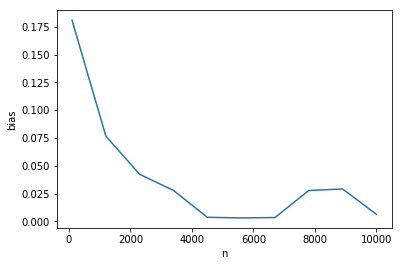

In [2]:
grid_n = np.linspace(100, 10000, 10).astype(int)
std = 1

th = np.log(std * np.sqrt(2 * np.pi * np.e))
print('Theoretical entropy : ', th)

entropies = []
for n in grid_n:
    x = np.random.normal(loc=0, scale=std, size=n).reshape(-1, 1)
    entropies.append(np.abs(entropy(x) - th))

plt.plot(grid_n, entropies)
plt.xlabel('n')
plt.ylabel('bias');

Now, If the data is composed of several iid. gaussians (so that d > 1) it still works

Theoretical entropy :  14.189385332046726


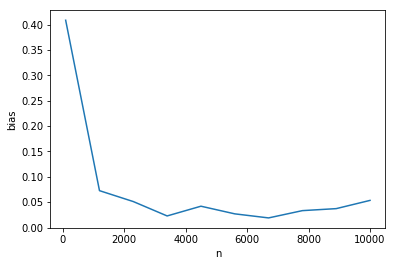

In [3]:
grid_n = np.linspace(100, 10000, 10).astype(int)

std = 1.
d = 10
th = d * np.log(std * np.sqrt(2 * np.pi * np.e))
print('Theoretical entropy : ', th)

entropies = []
for n in grid_n:
    x = np.random.normal(loc=0, scale=std, size=(n, d))
    entropies.append(np.abs(entropy(x) - th))

plt.plot(grid_n, entropies)
plt.xlabel('n')
plt.ylabel('bias');

In the case I have 2 correlated gaussian variables, I can still recover a fair enough estimation of the theoretical entropy

Theoretical entropy :  2.7507003728369566


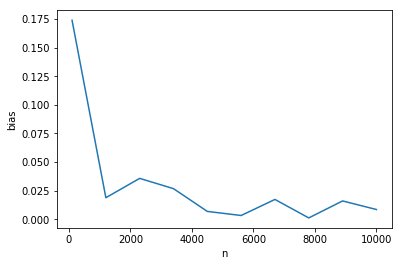

In [4]:
grid_n = np.linspace(100, 10000, 10).astype(int)
mu = [0, 0]
corr = 0.4
sigma = [[1, corr], [corr, 1]]

th = 1/2 * np.log((2 * np.pi * np.e)**2 * (1 - corr**2))
print('Theoretical entropy : ', th)

entropies = []
for n in grid_n:
    x = np.random.multivariate_normal(mu, sigma, n)
    entropies.append(np.abs(entropy(x) - th))

plt.plot(grid_n, entropies)
plt.xlabel('n')
plt.ylabel('bias');

Now, I verify that for 512 * 512 samples, for different values of M the chunk estimator recovers the theoretical entropy

In [5]:
N = 512 * 512
d = 3

X = np.random.normal(0, 1, (N, d))
th = d * np.log(np.sqrt(2 * np.pi * np.e))
print('Theory : ', th)
print('\n')
tic = time.time()
h = entropy(X)
toc = time.time()
print('KLD : bias : ', (h-th)**2, ' timing : ', toc-tic)
for m in [50, 100, 500, 1000]:
    tic = time.time()
    h = batch_entropy(X, M = m)
    toc = time.time()
    print('KLBD-%d : bias : ' % m, np.abs(h-th), ' timing : ', toc-tic)

Theory :  4.2568155996140185


KLD : bias :  5.7270824167888066e-06  timing :  1.863158941268921
KLBD-50 : bias :  0.0754319396627352  timing :  2.180079221725464
KLBD-100 : bias :  0.06365579783899733  timing :  1.4480175971984863
KLBD-500 : bias :  0.03543397182278696  timing :  1.016334056854248
KLBD-1000 : bias :  0.023172491842511356  timing :  1.0608181953430176


Assuming that they way Python shuffles, slices, performs Knn, ... leads to differences with the original paper,  I do not care too much about the execution times.
It seems that the bias of the chunk estimator indeed goes as $\frac{1}{\sqrt M}$.

<h3, style="text-align: center"> - TEST ON RGB IMAGES -</h3>

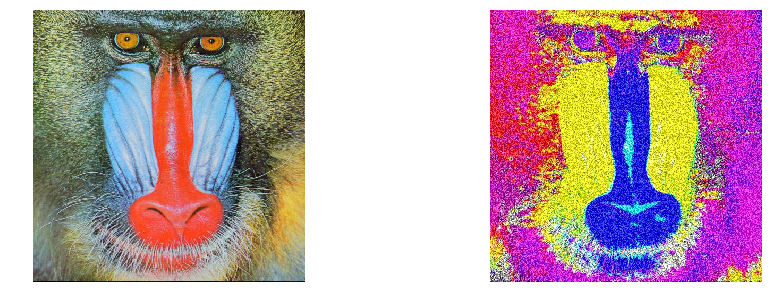

SSD
CPU time : 0.03

MI
CPU time : 0.05

CoMI
CPU time : 2.40



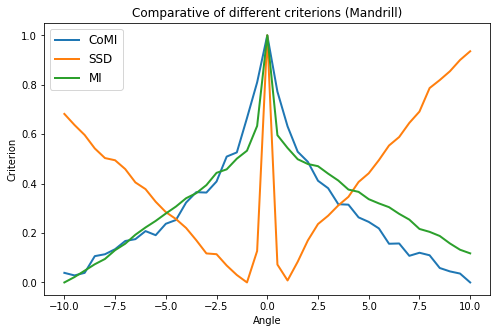

In [6]:
img1 = Image.open("./img/mandrill.jpg")
img2 = Image.open("./img/mandrill_modified.jpg")

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.imshow(img1)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.axis('off')
plt.show()

estimators = [SSD(), MI(), CoMI()]
results_mandrill = {}
for estimator in estimators:
    print(estimator.get_name())
    results_mandrill[estimator.get_name()], timing = test_estimator(estimator, img1, img2)
    print('CPU time : %.2f\n' % timing)
        
joblib.dump(results_mandrill, 'results_mandrill.pkl')

plt.figure(figsize=(8, 5))
for e in results_mandrill.items():
    plt.plot(np.arange(-10, 10.5, 0.5), min_max_scaler(e[1]), label = e[0], linestyle = '-', lw = 2)
        
plt.legend(fontsize = "large")
plt.xlabel('Angle')
plt.ylabel('Criterion')
plt.title('Comparative of different criterions (Mandrill)')
plt.show();

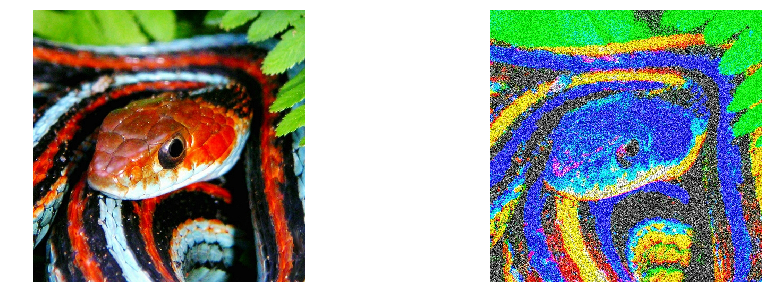

SSD
CPU time : 0.03

MI
CPU time : 0.05

CoMI
CPU time : 2.41



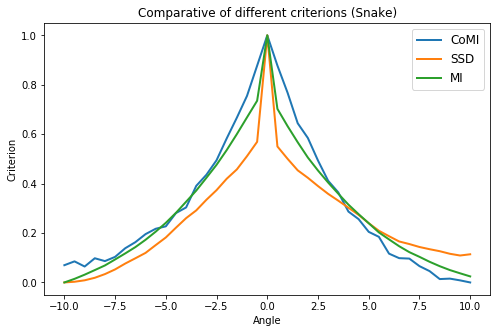

In [7]:
img1 = Image.open("./img/snake.jpg")
img2 = Image.open("./img/snake_modified.jpg")

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.imshow(img1)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.axis('off')
plt.show()

estimators = [SSD(), MI(), CoMI()]
results_snake = {}
for estimator in estimators:
    print(estimator.get_name())
    results_snake[estimator.get_name()], timing = test_estimator(estimator, img1, img2)
    print('CPU time : %.2f\n' % timing)
        
joblib.dump(results_snake, 'results_snake.pkl')

plt.figure(figsize=(8, 5))
for e in results_snake.items():
    plt.plot(np.arange(-10, 10.5, 0.5), min_max_scaler(e[1]), label = e[0], linestyle = '-', lw = 2)
        
plt.legend(fontsize = "large")
plt.xlabel('Angle')
plt.ylabel('Criterion')
plt.title('Comparative of different criterions (Snake)')
plt.show();

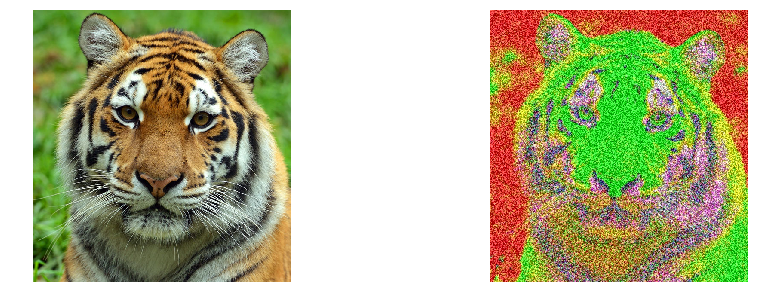

SSD
CPU time : 0.04

MI
CPU time : 0.07

CoMI
CPU time : 3.51



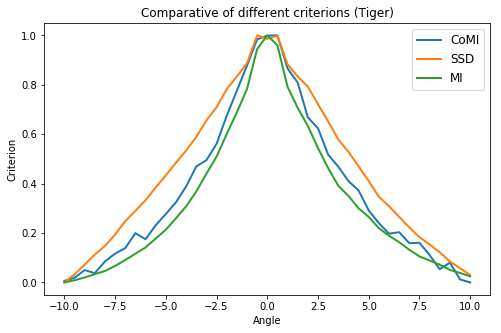

In [8]:
img1 = Image.open("./img/tiger.jpg")
img2 = Image.open("./img/tiger_modified.jpg")

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.imshow(img1)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.axis('off')
plt.show()

estimators = [SSD(), MI(), CoMI()]
results_tiger = {}
for estimator in estimators:
    print(estimator.get_name())
    results_tiger[estimator.get_name()], timing = test_estimator(estimator, img1, img2)
    print('CPU time : %.2f\n' % timing)
        
joblib.dump(results_tiger, 'results_tiger.pkl')

plt.figure(figsize=(8, 5))
for e in results_tiger.items():
    plt.plot(np.arange(-10, 10.5, 0.5), min_max_scaler(e[1]), label = e[0], linestyle = '-', lw = 2)
        
plt.legend(fontsize = "large")
plt.xlabel('Angle')
plt.ylabel('Criterion')
plt.title('Comparative of different criterions (Tiger)')
plt.show();

<h3, style="text-align: center"> - TEST ON GRAYSCALE IMAGES -</h3>

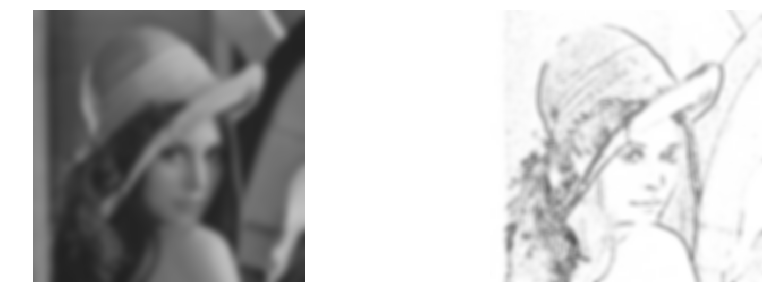

SSD
CPU time : 0.03

MI
CPU time : 0.04

NbMI
CPU time : 7.49



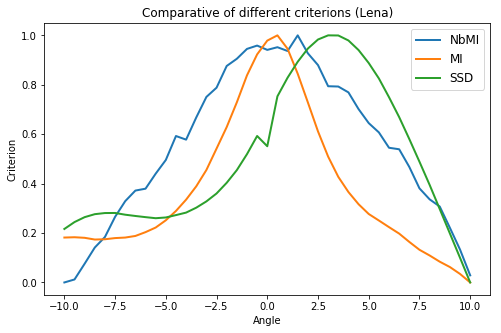

In [9]:
img1 = Image.open("./img/lena_blurred.png")
img2 = Image.open("./img/lena_edges_blurred.png")

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.imshow(img1)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.axis('off')
plt.show()

estimators = [SSD(), MI(), NbMI()]
results_lena = {}
for estimator in estimators:
    print(estimator.get_name())
    results_lena[estimator.get_name()], timing = test_estimator(estimator, img1, img2)
    print('CPU time : %.2f\n' % timing)
        
joblib.dump(results_lena, 'results_lena.pkl')

plt.figure(figsize=(8, 5))
for e in results_lena.items():
    plt.plot(np.arange(-10, 10.5, 0.5), min_max_scaler(e[1]), label = e[0], linestyle = '-', lw = 2)
        
plt.legend(fontsize = "large")
plt.xlabel('Angle')
plt.ylabel('Criterion')
plt.title('Comparative of different criterions (Lena)')
plt.show();

<h3, style="text-align: center"> - GEO TRACKING -</h3>

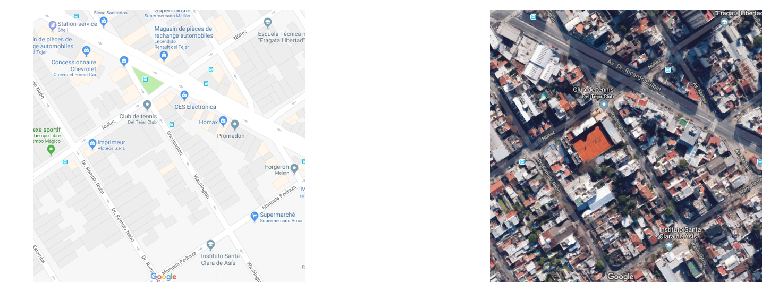

In [10]:
img1 = Image.open("./img/area_maps.jpg")
img2 = Image.open("./img/area_satellite.jpg")

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
plt.imshow(img1)
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(img2)
plt.axis('off')
plt.show()

SSD
CPU time : 0.03

MI
CPU time : 0.05

NbMI
CPU time : 6.15



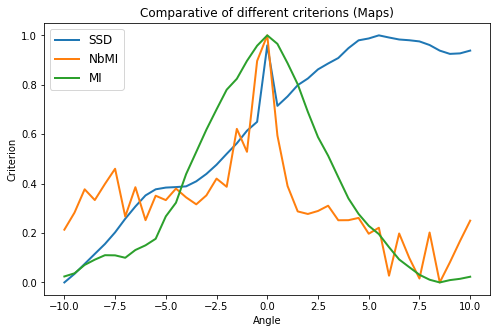

In [11]:
estimators = [SSD(), MI(), NbMI()]
results_maps = {}
for estimator in estimators:
    print(estimator.get_name())
    results_maps[estimator.get_name()], timing = test_estimator(estimator, img1, img2)
    print('CPU time : %.2f\n' % timing)
        
joblib.dump(results_maps, 'results_maps.pkl')

plt.figure(figsize=(8, 5))
for e in results_maps.items():
    plt.plot(np.arange(-10, 10.5, 0.5), min_max_scaler(e[1]), label = e[0], linestyle = '-', lw = 2)
        
plt.legend(fontsize = "large")
plt.xlabel('Angle')
plt.ylabel('Criterion')
plt.title('Comparative of different criterions (Maps)')
plt.show();

<h3, style="text-align: center"> - FACES SIMILARITY -</h3>

In [12]:
path = './img/faces/'

list_images = os.listdir(path)
scores = {}

def most_similar(file_name, dist_dict):
    file_map = [e for e in dist_dict.items() if file_name in e[0]]
    ix = np.argsort([e[1] for e in file_map])
    return [e.replace(file_name, '', 1).replace('-', '') for e in np.array([e[0] for e in file_map])[ix][::-1][:4]]

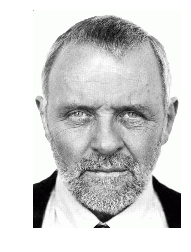

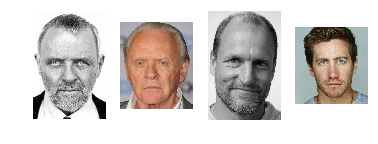

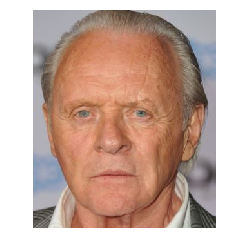

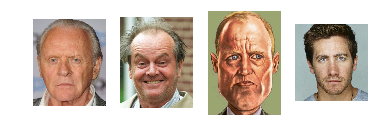

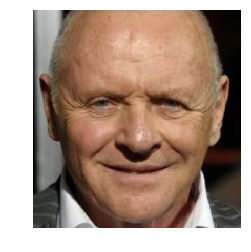

...

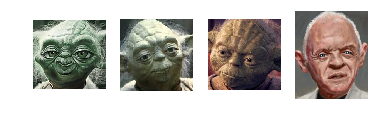

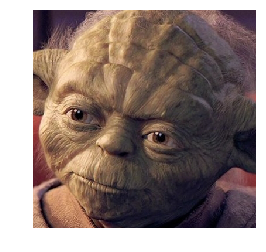

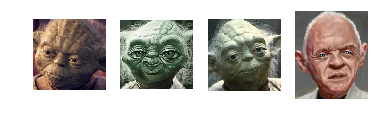

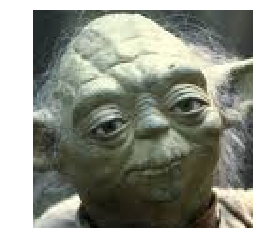

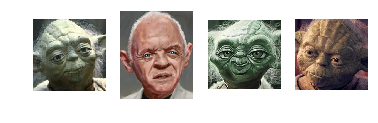

In [13]:
dist_ssd = {}
ssd = SSD()
for i in range(len(list_images)):
    for j in range(i, len(list_images)):
        img1 = np.asarray(Image.open(os.path.join(path, list_images[i])).resize((128, 128), Image.ANTIALIAS))
        img2 = np.asarray(Image.open(os.path.join(path, list_images[j])).resize((128, 128), Image.ANTIALIAS))
        dist_ssd['-'.join([list_images[i], list_images[j]])] = ssd.get_criterion(img1, img2)
        
score = 0
for img in list_images:
    plt.imshow(plt.imread(os.path.join(path, img)))
    plt.axis('off')
    plt.show()
    label = ''.join([e for e in img[:-3] if e.isalpha()])
    res = most_similar(img, dist_ssd)
    score += len([e for e in res if label in ''.join([e for e in e[:-3] if e.isalpha()])])
    plt.figure()
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(plt.imread(os.path.join(path, res[i])))
        plt.axis('off')
    plt.show()
    
score = score / (len(list_images) * 4)
scores['SSD'] = score

In [ ]:
dist_mi = {}
mi = MI()
for i in range(len(list_images)):
    for j in range(i, len(list_images)):
        img1 = np.asarray(Image.open(os.path.join(path, list_images[i])).resize((128, 128), Image.ANTIALIAS))
        img2 = np.asarray(Image.open(os.path.join(path, list_images[j])).resize((128, 128), Image.ANTIALIAS))
        dist_mi['-'.join([list_images[i], list_images[j]])] = mi.get_criterion(img1, img2)
        
score = 0
for img in list_images:
    plt.imshow(plt.imread(os.path.join(path, img)))
    plt.axis('off')
    plt.show()
    label = ''.join([e for e in img[:-3] if e.isalpha()])
    res = most_similar(img, dist_mi)
    score += len([e for e in res if label in ''.join([e for e in e[:-3] if e.isalpha()])])
    plt.figure()
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(plt.imread(os.path.join(path, res[i])))
        plt.axis('off')
    plt.show()
    
score = score / (len(list_images) * 4)
scores['MI'] = score

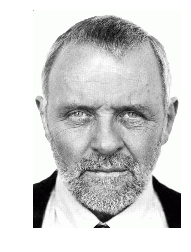

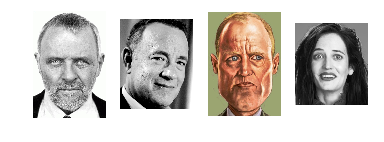

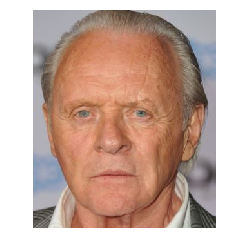

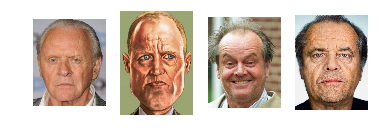

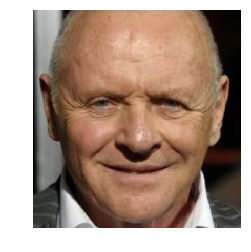

...

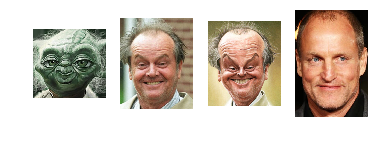

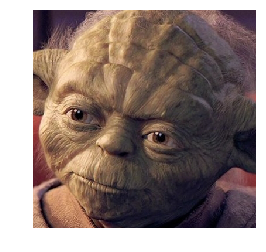

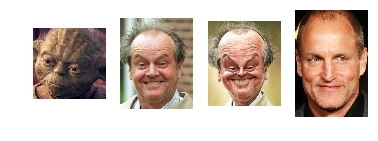

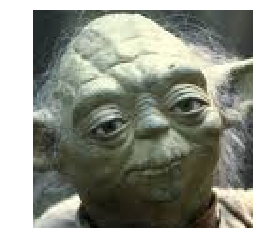

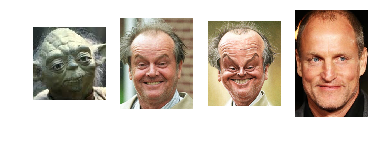

In [15]:
dist_comi = {}
comi = CoMI()
for i in range(len(list_images)):
    for j in range(i, len(list_images)):
        img1 = np.asarray(Image.open(os.path.join(path, list_images[i])).resize((128, 128), Image.ANTIALIAS))
        img2 = np.asarray(Image.open(os.path.join(path, list_images[j])).resize((128, 128), Image.ANTIALIAS))
        dist_comi['-'.join([list_images[i], list_images[j]])] = comi.get_criterion(img1, img2)
        
score = 0
for img in list_images:
    plt.imshow(plt.imread(os.path.join(path, img)))
    plt.axis('off')
    plt.show()
    label = ''.join([e for e in img[:-3] if e.isalpha()])
    res = most_similar(img, dist_comi)
    score += len([e for e in res if label in ''.join([e for e in e[:-3] if e.isalpha()])])
    plt.figure()
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(plt.imread(os.path.join(path, res[i])))
        plt.axis('off')
    plt.show()
    
score = score / (len(list_images) * 4)
scores['CoMI'] = score

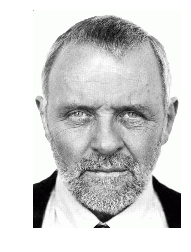

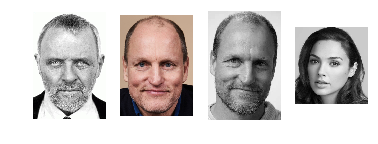

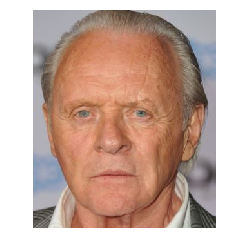

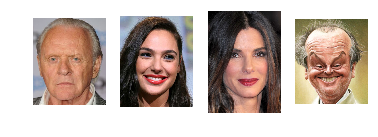

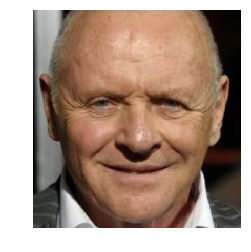

...

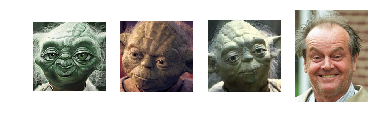

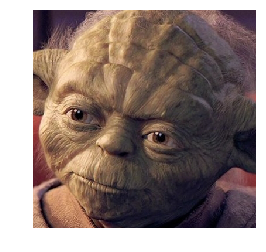

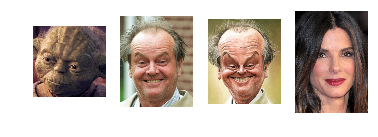

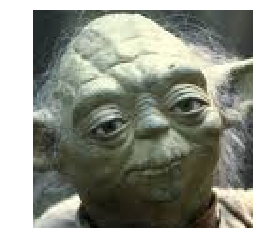

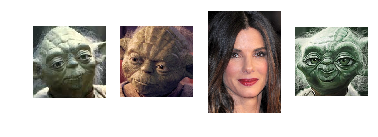

In [16]:
dist_nbmi = {}
nbmi = NbMI()
for i in range(len(list_images)):
    for j in range(i, len(list_images)):
        img1 = np.asarray(Image.open(os.path.join(path, list_images[i])).resize((128, 128), Image.ANTIALIAS))
        img2 = np.asarray(Image.open(os.path.join(path, list_images[j])).resize((128, 128), Image.ANTIALIAS))
        dist_nbmi['-'.join([list_images[i], list_images[j]])] = nbmi.get_criterion(img1, img2)
        
score = 0
for img in list_images:
    plt.imshow(plt.imread(os.path.join(path, img)))
    plt.axis('off')
    plt.show()
    label = ''.join([e for e in img[:-3] if e.isalpha()])
    res = most_similar(img, dist_nbmi)
    score += len([e for e in res if label in ''.join([e for e in e[:-3] if e.isalpha()])])
    plt.figure()
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(plt.imread(os.path.join(path, res[i])))
        plt.axis('off')
    plt.show()
    
score = score / (len(list_images) * 4)
scores['NbMI'] = score

In [17]:
for e in scores.items():
    print("%s  :  %.2f" % (e[0], e[1]))

SSD  :  0.49
CoMI  :  0.33
NbMI  :  0.42
MI  :  0.47
